
# Basic example

We demonstrate how to use ``GGLasso`` for a SGL problem. 
First, we generate a sparse Erdos-Renyi network of 20 nodes. We generate an according precision matrix and sample from it. Here, we use a large 
number of samples (N=1000) to demonstrate that it is possible to recover (approximately) the original graph if sufficiently many samples are available.

In many practical applications however, we face the situation of p>N.


In [1]:
# sphinx_gallery_thumbnail_number = 2

from gglasso.helper.data_generation import generate_precision_matrix, group_power_network, sample_covariance_matrix
from gglasso.problem import glasso_problem
from gglasso.helper.basic_linalg import adjacency_matrix
from estimate_connectivity import estimate_graph_connectivity, printPretty

import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import rankdata 

p = 3
N = 1000

Sigma, Theta = generate_precision_matrix(p=p, M=1, style='erdos', prob=0.1, seed=1234)

def sample_covariance_matrix(Sigma, N, seed=None, deterministic=False):
    """
    Samples data for a given covariance matrix Sigma (with K layers).
    Returns: sample covariance matrix S and the sampled data.
    """
    if deterministic:
        rng = None
    else:
        rng = np.random.default_rng(seed)

    if len(Sigma.shape) == 2:
        # Case for a single covariance matrix
        assert abs(Sigma - Sigma.T).max() <= 1e-10
        (p, p) = Sigma.shape
        
        if deterministic:
            # Generate predefined deterministic samples
            predefined_samples = np.tile(np.arange(p), (N, 1)).T  # Shape: (p, N)
            sample = np.linalg.cholesky(Sigma) @ predefined_samples
        else:
            sample = rng.multivariate_normal(np.zeros(p), Sigma, N).T
            
        S = np.cov(sample, bias=True)
        
    else:
        # Case for multiple covariance matrices
        assert abs(Sigma - np.transpose(Sigma, axes=(0, 2, 1))).max() <= 1e-10
        (K, p, p) = Sigma.shape

        sample = np.zeros((K, p, N))
        for k in np.arange(K):
            if deterministic:
                # Generate predefined deterministic samples for each layer
                predefined_samples = np.tile(np.arange(p), (N, 1)).T  # Shape: (p, N)
                sample[k, :, :] = np.linalg.cholesky(Sigma[k, :, :]) @ predefined_samples
            else:
                sample[k, :, :] = rng.multivariate_normal(np.zeros(p), Sigma[k, :, :], N).T
    
        S = np.zeros((K, p, p))
        for k in np.arange(K):
            S[k, :, :] = np.cov(sample[k, :, :], bias=True)
            
    return S, sample

S, sample = sample_covariance_matrix(Sigma, N, deterministic=True)

print("Shape of empirical covariance matrix: ", S.shape)
print("Shape of the sample array: ", sample.shape)


printPretty(sample)

y_ground_truth_ranking = rankdata(sample[:, 0], method='ordinal')
print(y_ground_truth_ranking)

Shape of empirical covariance matrix:  (3, 3)
Shape of the sample array:  (3, 1000)
    0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0  

## Draw the graph of the true precision matrix.



    0        0        0    
    0        0        1.00 
    0        1.00     0    
Vectorized A:  [0 0 0 0 0 1 0 1 0]
h_matrix shape:  (9, 9)
sample:  (3, 1000)
(9, 9)
(3, 9)
[0.00128979 0.17304373 0.14259587]
[2.00003521e-04 3.60006338e+00 2.44462551e+00]
H_true: 
   -0.02     0.01    -0.00     0.01    -0.02     0.02     0.02    -0.01     0.01 
   -2.78     1.72    -0.54     1.16    -2.51     2.71     2.19    -1.17     0.77 
   -2.29     1.42    -0.45     0.95    -2.07     2.23     1.80    -0.96     0.64 


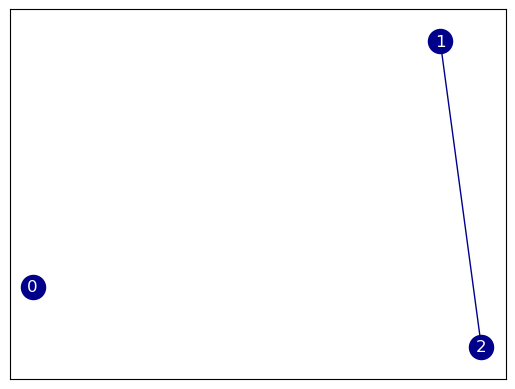

In [2]:
A = adjacency_matrix(Theta)

printPretty(A)

G = nx.from_numpy_array(A)
pos = nx.drawing.layout.spring_layout(G, seed = 1234)

plt.figure()
nx.draw_networkx(G, pos = pos, node_color = "darkblue", edge_color = "darkblue", font_color = 'white', with_labels = True)

# vectorize A for debugging
vec_A = A.flatten()
print("Vectorized A: ", vec_A)
# make column vector of vec_A
vec_A = vec_A.reshape(-1,1)
# print("Reshaped A: ", vec_A)
# make 9 copies of vec_A and put into matrix
h_matrix = np.tile(vec_A, (1,(p*p)))
print("h_matrix shape: ", h_matrix.shape)

# get the first 9 y samples
print("sample: ", sample.shape)
# take only the first 9 samples
y = sample[:, :(p*p)]

# change all the elements in the first row of y to 0.01
y[0,:] = 0.01


# add a little noise to h_matrix
h_matrix = h_matrix + 0.1*np.random.randn(p*p,p*p)

# get dimensions of 
print(np.linalg.inv(h_matrix).shape)
print(y.shape)

H_true = y @ np.linalg.inv(h_matrix)

# give me the averages of every row in H
print(H_true.mean(axis=1))
# get me the variances of every row in H
print(H_true.var(axis=1))



print("H_true: ")
printPretty(H_true)


Samples 1000
Shape of sample array:  (3, 1000)
The origional graph data is
    0.01     0.01     0.01     0.01     0.01     0.01     0.01     0.01     0.01     0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0        0  

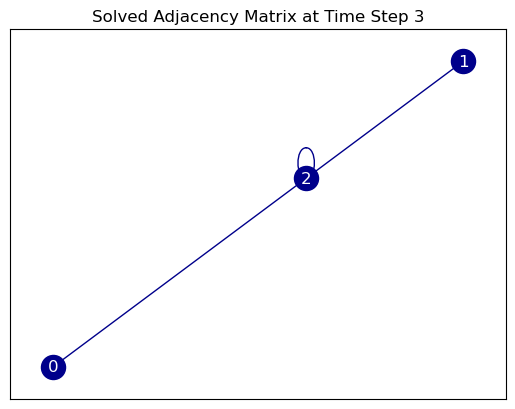

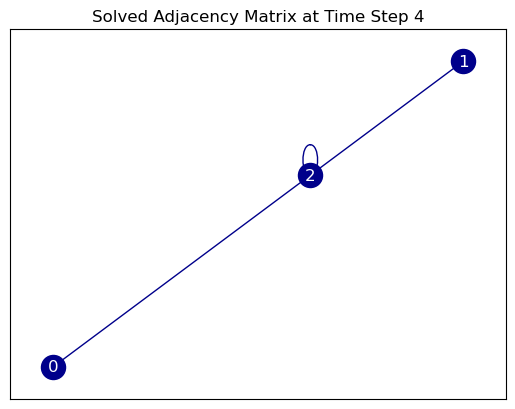

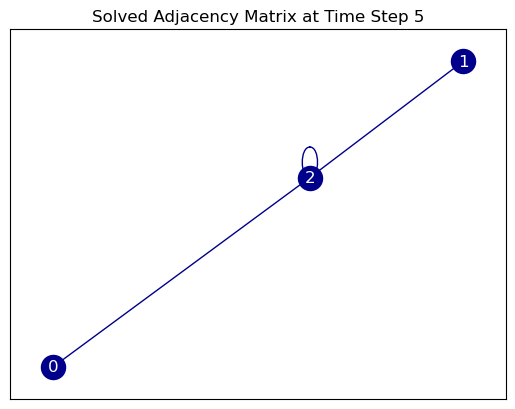

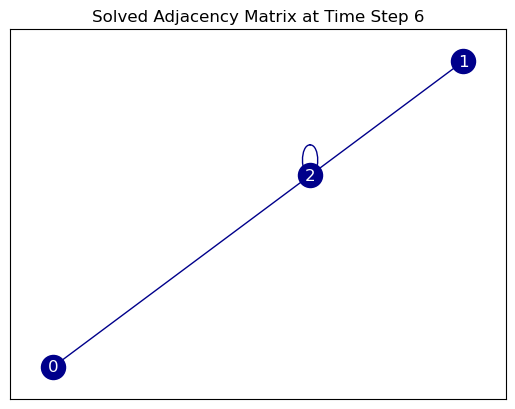

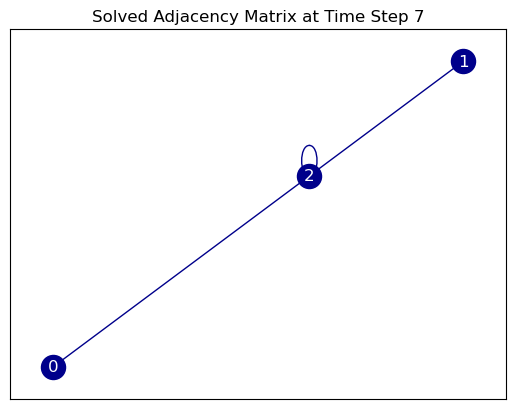

...

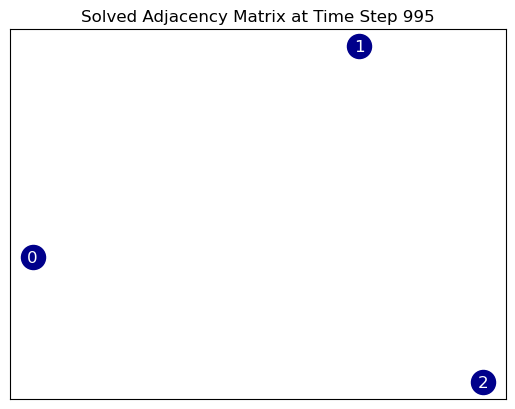

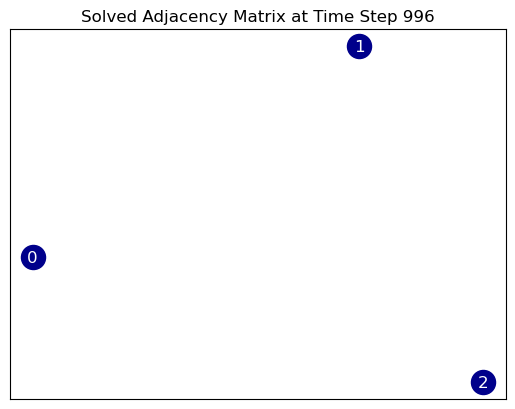

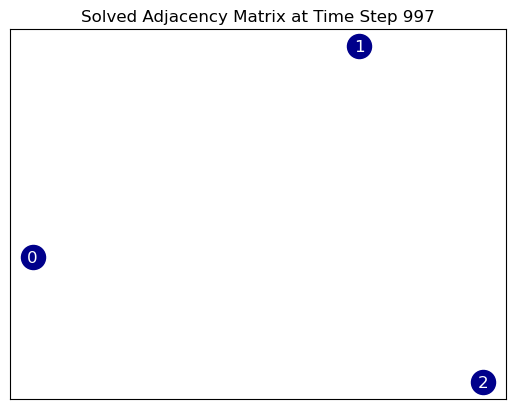

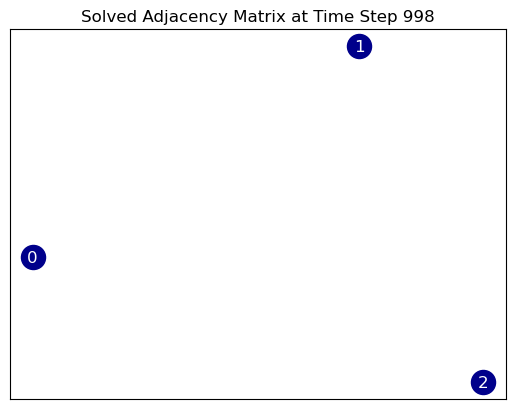

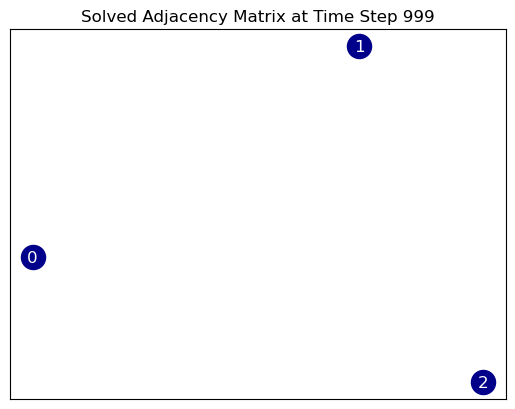

In [3]:
# Now running my algorithm to recognize graph topology

from estimate_connectivity import estimate_graph_connectivity

NODES = p
SAMPLES = N
print("Samples", SAMPLES)

EPSILON = 1e-10
VALUE_THRESHOLD = 1e10
ALPHA = 0.9


# estimate_graph_connectivity(Y, lambda_param, alpha, Q_initial, R_initial, F_initial, H_initial, max_iter=100)

Q_initial = np.eye(NODES*NODES) # correct dimensions
R_initial = np.eye(NODES)
H_initial = np.random.randn(NODES, NODES*NODES) 
F_initial = np.random.randn(NODES*NODES, NODES*NODES)


print("Shape of sample array: ", sample.shape)

Y = sample[:NODES, :SAMPLES] # should already be of these dimensions but just to check

print("The origional graph data is")
printPretty(Y)

lambda_param = 0.1
alpha = 0.95

# Estimate graph connectivity
A_estimated_GGLASSO_gen = estimate_graph_connectivity(Y, lambda_param, alpha, Q_initial, R_initial, F_initial, H_initial)

# Compare it with true adjacency from SEM
print("Solved Adjacency Matrix from SEM")
for i in range(SAMPLES):
    print(f"Time Step {i}")
    printPretty(A_estimated_GGLASSO_gen[:, :, i])

# If the value in the adjacency matrix is less than 0.05, set to 0
A_estimated_GGLASSO_gen[A_estimated_GGLASSO_gen < 0.05] = 0

# Plot all solved adjacency matrices in graph form and compare them to the original version
for i in range(3, SAMPLES):
    G_estimated = nx.from_numpy_array(A_estimated_GGLASSO_gen[:, :, i])
    pos_estimated = nx.drawing.layout.spring_layout(G_estimated, seed=1234)
    
    plt.figure()
    nx.draw_networkx(G_estimated, pos=pos_estimated, node_color="darkblue", edge_color="darkblue", font_color='white', with_labels=True)
    plt.title(f"Solved Adjacency Matrix at Time Step {i}")
    plt.show()

 

